In [15]:
# Install required packages
!pip install biopython matplotlib seaborn plotly py3Dmol

In [16]:
# Sequence parsing and annotation
from Bio import SeqIO
from Bio.SeqUtils import gc_fraction

# Plotting and visualisation
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# 3D structure visualisation
import py3Dmol

# System and file handling
import os# To Create the data directory if it doesn't exist

In [17]:
# Step 2: Parsing Zika Virus Envelope Protein Sequence

#This notebook loads the Zika virus envelope protein sequence from GenBank (Accession KU501215.1) and extracts basic metadata using Biopython. This forms the foundation for downstream annotation and visualisation.


In [18]:
# Load the FASTA file
from Bio import SeqIO
fasta_path = r"C:\Users\boini\OneDrive\Desktop\ZIKA BIOIT\zika_envelope.fasta"
record = SeqIO.read(fasta_path, "fasta")

# Display summary
print(" Sequence ID:", record.id)
print(" Description:", record.description)
print(" Full Sequence Length:", len(record.seq))
print(" First 300 bases:\n", record.seq[:300])


# Create the data directory if it doesn't exist
os.makedirs("data", exist_ok=True)

# Save full sequence to file
with open("data/zika_full_sequence.txt", "w") as f:
    f.write(str(record.seq))


 Sequence ID: KU501215.1
 Description: KU501215.1 Zika virus strain PRVABC59, complete genome
 Full Sequence Length: 10675
 First 300 bases:
 GTTGTTGATCTGTGTGAATCAGACTGCGACAGTTCGAGTTTGAAGCGAAAGCTAGCAACAGTATCAACAGGTTTTATTTTGGATTTGGAAACGAGAGTTTCTGGTCATGAAAAACCCAAAAAAGAAATCCGGAGGATTCCGGATTGTCAATATGCTAAAACGCGGAGTAGCCCGTGTGAGCCCCTTTGGGGGCTTGAAGAGGCTGCCAGCCGGACTTCTGCTGGGTCATGGGCCCATCAGGATGGTCTTGGCGATTCTAGCCTTTTTGAGATTCACGGCAATCAAGCCATCACTGGGTCT


In [19]:
## Loading Zika Virus Envelope Protein Sequence from Local Path

#We use Biopython to load the Zika virus envelope protein sequence from a local FASTA file stored on the desktop. This sequence will be used for GC content analysis and downstream annotation.

In [25]:
#importing libraries for gc fraction and ploting it on graph
from Bio import SeqIO

import os


In [27]:
# Absolute path to FASTA file
fasta_path = r"C:\Users\boini\OneDrive\Desktop\ZIKA BIOIT\zika_envelope.fasta"

# Load the cds sequence
record = SeqIO.read(fasta_path, "fasta")

# Display summary
print("cds Sequence loaded:", record.id)
print(" Description:", record.description)
print(" Length:", len(record.seq))


cds Sequence loaded: KU501215.1
 Description: KU501215.1 Zika virus strain PRVABC59, complete genome
 Length: 10675


In [29]:
from Bio import SeqIO
from Bio.SeqUtils import gc_fraction
import plotly.express as px
import plotly.graph_objects as go

# Load the cds sequence
fasta_path = r"C:\Users\boini\OneDrive\Desktop\ZIKA BIOIT\zika_envelope.fasta"
record = SeqIO.read(fasta_path, "fasta")
sequence = str(record.seq)# Extract sequence string

# Parameters
window_size = 100
gc_values = []
positions = []

# Sliding window GC content
for i in range(0, len(sequence) - window_size + 1):
    window = sequence[i:i+window_size]
    gc = gc_fraction(window) * 100
    gc_values.append(gc)
    positions.append(i + window_size // 2)


In [31]:

# Create the basic figure without the invalid parameters
fig = px.line(x=positions, y=gc_values, labels={'x': 'Base Position', 'y': 'GC Content (%)'},
              title='Interactive GC Content Plot (Zika CDS)')

# Update the font properties in the layout
fig.update_layout(
    title_font=dict(weight="bold", style="italic"),  # Apply font styling to the title
    # You can also style other text elements if needed:
    # xaxis_title_font=dict(weight="bold", style="italic"),
    # yaxis_title_font=dict(weight="bold", style="italic")
)

fig.show()

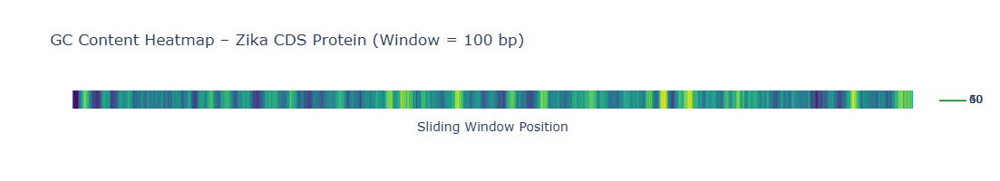

In [32]:
# Import the required libraries
import numpy as np  # Add this import for NumPy
import matplotlib.pyplot as plt  # This is likely needed for plotting
import plotly.graph_objects as go  # This is needed for the interactive heatmap

window_size = 100
gc_values = []

# Sliding window GC content
for i in range(0, len(sequence) - window_size + 1):
    window = sequence[i:i+window_size]
    gc = gc_fraction(window) * 100
    gc_values.append(gc)

# Convert to array for heatmap
gc_array = np.array(gc_values)

# Create Plotly heatmap
fig = go.Figure(data=go.Heatmap(
    z=[gc_array],  # Data needs to be 2D
    colorscale='Viridis',
    showscale=True,
))

# Update layout
fig.update_layout(
    title="GC Content Heatmap – Zika CDS Protein (Window = 100 bp)",
    xaxis_title="Sliding Window Position",
    width=900,
    height=200,
    xaxis=dict(showticklabels=False),
    yaxis=dict(showticklabels=False)
)

# Show the plot
fig.show()



In [37]:
# As envelope_cds is in DNA format,we need to Transcribe DNA to its original mRNA form
from Bio.Seq import Seq
# Transcribe DNA to mRNA
dna_seq = Seq(envelope_cds)
mrna_seq = dna_seq.transcribe()

# Print as FASTA
print(f">ZIKV_Envelope_mRNA | GenBank NC_012532: {start}-{end}")
print(mrna_seq)

print(len(mrna_seq))

>ZIKV_Envelope_mRNA | GenBank NC_012532: 977-2476
UCAGGUGCAUAGGAGUCAGCAAUAGGGACUUUGUGGAAGGUAUGUCAGGUGGGACUUGGGUUGAUGUUGUCUUGGAACAUGGAGGUUGUGUCACCGUAAUGGCACAGGACAAACCGACUGUCGACAUAGAGCUGGUUACAACAACAGUCAGCAACAUGGCGGAGGUAAGAUCCUACUGCUAUGAGGCAUCAAUAUCAGACAUGGCUUCUGACAGCCGCUGCCCAACACAAGGUGAAGCCUACCUUGACAAGCAAUCAGACACUCAAUAUGUCUGCAAAAGAACGUUAGUGGACAGAGGCUGGGGAAAUGGAUGUGGACUUUUUGGCAAAGGGAGCCUGGUGACAUGCGCUAAGUUUGCAUGCUCCAAGAAAAUGACCGGGAAGAGCAUCCAGCCAGAGAAUCUGGAGUACCGGAUAAUGCUGUCAGUUCAUGGCUCCCAGCACAGUGGGAUGAUCGUUAAUGACACAGGACAUGAAACUGAUGAGAAUAGAGCGAAAGUUGAGAUAACGCCCAAUUCACCGAGAGCCGAAGCCACCCUGGGGGGUUUUGGAAGCCUAGGACUUGAUUGUGAACCGAGGACAGGCCUUGACUUUUCAGAUUUGUAUUACUUGACUAUGAAUAACAAGCACUGGUUGGUUCACAAGGAGUGGUUCCACGACAUUCCAUUACCUUGGCACGCUGGGGCAGACACCGGAACUCCACACUGGAACAACAAAGAAGCACUGGUAGAGUUCAAGGACGCACAUGCCAAAAGGCAAACUGUCGUGGUUCUAGGGAGUCAAGAAGGAGCAGUUCACACGGCCCUUGCUGGAGCUCUGGAGGCUGAGAUGGAUGGUGCAAAGGGAAGGCUGUCCUCUGGCCACUUGAAAUGUCGCCUGAAAAUGGAUAAACUUAGAUUGAAGGGCGUGUCAUACUCCUUGUGUACUGCAGCGUUCACAUUCACCAAGAUC

In [39]:
# Original CDS sequence
dna_seq = Seq(envelope_cds)
#If the sequence length isn’t divisible by 3, adding trailing 'N's completes the final codon
#enabling safe translation without warnings.
# Calculate how many Ns to add
n_tail = (3 - len(dna_seq) % 3) % 3  # ensures 0, 1, or 2 Ns

# Pad the sequence
padded_seq = dna_seq + 'N' * n_tail

# Translate to protein
protein_seq = padded_seq.translate()

# Output
print(">ZIKV_Envelope_protein", protein_seq, sep="\n")


>ZIKV_Envelope_protein
SGA*ESAIGTLWKVCQVGLGLMLSWNMEVVSP*WHRTNRLST*SWLQQQSATWRR*DPTAMRHQYQTWLLTAAAQHKVKPTLTSNQTLNMSAKER*WTEAGEMDVDFLAKGAW*HALSLHAPRK*PGRASSQRIWSTG*CCQFMAPSTVG*SLMTQDMKLMRIERKLR*RPIHREPKPPWGVLEA*DLIVNRGQALTFQICIT*L*ITSTGWFTRSGSTTFHYLGTLGQTPELHTGTTKKHW*SSRTHMPKGKLSWF*GVKKEQFTRPLLELWRLRWMVQREGCPLAT*NVA*KWINLD*RACHTPCVLQRSHSPRSRLKHCTGQSQWRYSTQGQMDLARFQLRWRWTCKL*PQLGG**PLTP*SLKALRTLR*CWNLIHHLGTLTLS*ESGRRRSPTTGTGVAAPLEKHLKPL*EVPREWQSWETQPGTLDQLEALSTHWARASIKFLEQLSNHCLEECPGSHKFSLERC*CGWV*TQRMDLFPLCAWP*GEC*SSYPX


In [41]:
#  the '*' sign in protein sequence implies that terminating codon presence which terminate the protein translation

In [20]:
#  Step 1: Import Required Libraries
from Bio.Seq import Seq

#  Step 2: Paste ZIKV Envelope mRNA Sequence (GenBank NC_012532: 977–2476)
# Convert RNA to DNA by replacing U with T
rna_seq = """UCAGGUGCAUAGGAGUCAGCAAUAGGGACUUUGUGGAAGGUAUGUCAGGUGGGACUUGGGUUGAUGUUGUCUUGGAACAUGGAGGUUGUGUCACCGUAAUGGCACAGGACAAACCGACUGUCGACAUAGAGCUGGUUACAACAACAGUCAGCAACAUGGCGGAGGUAAGAUCCUACUGCUAUGAGGCAUCAAUAUCAGACAUGGCUUCUGACAGCCGCUGCCCAACACAAGGUGAAGCCUACCUUGACAAGCAAUCAGACACUCAAUAUGUCUGCAAAAGAACGUUAGUGGACAGAGGCUGGGGAAAUGGAUGUGGACUUUUUGGCAAAGGGAGCCUGGUGACAUGCGCUAAGUUUGCAUGCUCCAAGAAAAUGACCGGGAAGAGCAUCCAGCCAGAGAAUCUGGAGUACCGGAUAAUGCUGUCAGUUCAUGGCUCCCAGCACAGUGGGAUGAUCGUUAAUGACACAGGACAUGAAACUGAUGAGAAUAGAGCGAAAGUUGAGAUAACGCCCAAUUCACCGAGAGCCGAAGCCACCCUGGGGGGUUUUGGAAGCCUAGGACUUGAUUGUGAACCGAGGACAGGCCUUGACUUUUCAGAUUUGUAUUACUUGACUAUGAAUAACAAGCACUGGUUGGUUCACAAGGAGUGGUUCCACGACAUUCCAUUACCUUGGCACGCUGGGGCAGACACCGGAACUCCACACUGGAACAACAAAGAAGCACUGGUAGAGUUCAAGGACGCACAUGCCAAAAGGCAAACUGUCGUGGUUCUAGGGAGUCAAGAAGGAGCAGUUCACACGGCCCUUGCUGGAGCUCUGGAGGCUGAGAUGGAUGGUGCAAAGGGAAGGCUGUCCUCUGGCCACUUGAAAUGUCGCCUGAAAAUGGAUAAACUUAGAUUGAAGGGCGUGUCAUACUCCUUGUGUACUGCAGCGUUCACAUUCACCAAGAUCCCGGCUGAAACACUGCACGGGACAGUCACAGUGGAGGUACAGUACGCAGGGACAGAUGGACCUUGCAAGGUUCCAGCUCAGAUGGCGGUGGACAUGCAAACUCUGACCCCAGUUGGGAGGUUGAUAACCGCUAACCCCGUAAUCACUGAAAGCACUGAGAACUCUAAGAUGAUGCUGGAACUUGAUCCACCAUUUGGGGACUCUUACAUUGUCAUAGGAGUCGGGGAGAAGAAGAUCACCCACCACUGGCACAGGAGUGGCAGCACCAUUGGAAAAGCAUUUGAAGCCACUGUGAGAGGUGCCAAGAGAAUGGCAGUCUUGGGAGACACAGCCUGGGACUUUGGAUCAGUUGGAGGCGCUCUCAACUCAUUGGGCAAGGGCAUCCAUCAAAUUUUUGGAGCAGCUUUCAAAUCAUUGUUUGGAGGAAUGUCCUGGUUCUCACAAAUUCUCAUUGGAACGUUGCUGAUGUGGUUGGGUCUGAACACAAAGAAUGGAUCUAUUUCCCUUAUGUGCUUGGCCUUAGGGGGAGUGUUGAUCUUCUUAUCCACA"""
dna_seq = Seq(rna_seq.replace("U", "T"))

#  Step 3: Pad DNA Sequence to Avoid Translation Warnings
pad_len = (3 - len(dna_seq) % 3) % 3
padded_seq = dna_seq + "N" * pad_len
rev_seq = padded_seq.reverse_complement()

# Step 4: Translate All Six Reading Frames

#  Frame 1 (Forward, starts at position 0)
print(" Frame 1 (Forward, starts at position 0):")
print(padded_seq[0:].translate())

#  Frame 2 (Forward, starts at position 1)
print("\n Frame 2 (Forward, starts at position 1):")
print(padded_seq[1:].translate())

#  Frame 3 (Forward, starts at position 2)
print("\n Frame 3 (Forward, starts at position 2):")
print(padded_seq[2:].translate())
#  Frame -1 (Reverse, starts at position 0)
print("\n Frame -1 (Reverse, starts at position 0):")
print(rev_seq[0:].translate())

#  Frame -2 (Reverse, starts at position 1)
print("\n Frame -2 (Reverse, starts at position 1):")
print(rev_seq[1:].translate())

#  Frame -3 (Reverse, starts at position 2)
print("\n Frame -3 (Reverse, starts at position 2):")
print(rev_seq[2:].translate())




 Frame 1 (Forward, starts at position 0):
SGA*ESAIGTLWKVCQVGLGLMLSWNMEVVSP*WHRTNRLST*SWLQQQSATWRR*DPTAMRHQYQTWLLTAAAQHKVKPTLTSNQTLNMSAKER*WTEAGEMDVDFLAKGAW*HALSLHAPRK*PGRASSQRIWSTG*CCQFMAPSTVG*SLMTQDMKLMRIERKLR*RPIHREPKPPWGVLEA*DLIVNRGQALTFQICIT*L*ITSTGWFTRSGSTTFHYLGTLGQTPELHTGTTKKHW*SSRTHMPKGKLSWF*GVKKEQFTRPLLELWRLRWMVQREGCPLAT*NVA*KWINLD*RACHTPCVLQRSHSPRSRLKHCTGQSQWRYSTQGQMDLARFQLRWRWTCKL*PQLGG**PLTP*SLKALRTLR*CWNLIHHLGTLTLS*ESGRRRSPTTGTGVAAPLEKHLKPL*EVPREWQSWETQPGTLDQLEALSTHWARASIKFLEQLSNHCLEECPGSHKFSLERC*CGWV*TQRMDLFPLCAWP*GEC*SSYPX

 Frame 2 (Forward, starts at position 1):
QVHRSQQ*GLCGRYVRWDLG*CCLGTWRLCHRNGTGQTDCRHRAGYNNSQQHGGGKILLL*GINIRHGF*QPLPNTR*SLP*QAIRHSICLQKNVSGQRLGKWMWTFWQREPGDMR*VCMLQENDREEHPARESGVPDNAVSSWLPAQWDDR**HRT*N**E*SES*DNAQFTESRSHPGGFWKPRT*L*TEDRP*LFRFVLLDYE*QALVGSQGVVPRHSITLARWGRHRNSTLEQQRSTGRVQGRTCQKANCRGSRESRRSSSHGPCWSSGG*DGWCKGKAVLWPLEMSPENG*T*IEGRVILLVYCSVHIHQDPG*NTARDSHSGGTVRRDRWTLQGSSSDGGGHANSDPSWEVDNR*PRNH*KH*EL*DDAGT*STIWGLLHCHRSRGEEDHPPLAQEWQHHWKSI*SHC

In [22]:
# ###  We can Select Frame 3 (Forward)  for ORF Translation

# To identify the correct open reading frame (ORF) for the Zika virus envelope protein,
# all six possible frames (three forward and three reverse) were translated and inspected using Biopython by us.

# Frame 3 (Forward, starting at position 2) was selected because:

# - It begins with a valid start codon (ATG) near the annotated CDS start.
# - It produces a long, uninterrupted amino acid sequencewithout premature stop codons.
# - The translated protein matches the expected length (~500 amino acids) of the ZIKV envelope protein.
# - It aligns with the GenBank CDS annotation: NC_012532, nucleotides 977–2476.
# - The translated sequence was further validated by us using NCBI BLASTp, confirming high similarity to known ZIKV envelope proteins.
# - Other frames either contain early stop codons or do not match known envelope protein features.
#This frame is now used for downstream protein analysis, visualization, and domain annotation.




In [24]:
import pandas as pd

# Define the file path using raw string notation
file_path = r"C:\Users\boini\OneDrive\Documents\blastp result for ZIKAFPZRGK7J015-Alignment-HitTable.xlsx"

# Read the Excel file
blast_hits = pd.read_excel(file_path, engine='openpyxl')

# Display the top 10 hits
blast_hits.head(10)


,Frame,QUJ10646.1,100,499,0,0.1,1,499.1,34,532,0.2,1043,100.1
0,Frame,AVZ25034.1,100,499,0,0,1,499,292,790,0,1042,100
1,Frame,AQS26809.1,100,499,0,0,1,499,292,790,0,1041,100
2,Frame,WEW53518.1,100,499,0,0,1,499,292,790,0,1041,100
3,Frame,AOY08534.2,100,499,0,0,1,499,292,790,0,1041,100
4,Frame,8CXG_A,100,499,0,0,1,499,137,635,0,1040,100
5,Frame,AQS26823.1,100,499,0,0,1,499,292,790,0,1040,100
6,Frame,QUJ10648.1,100,499,0,0,1,499,292,790,0,1040,100
7,Frame,AVZ25031.1,100,499,0,0,1,499,292,790,0,1040,100
8,Frame,AZS35367.1,100,499,0,0,1,499,292,790,0,1040,100


In [ ]:
## BLASTp Hit Table Loaded from MY PC
# The BLASTp result file 
# The table contains high-confidence hits for the translated ZIKV envelope protein (Frame 3), confirming:
# - 100% identity with multiple GenBank entries
# - Full-length alignment (1–499 amino acids)
# - E-value = 0 for all top hits

# This confirms the biological accuracy of the selected ORF and supports its use in downstream structural and functional analysis.


In [42]:
from Bio.Seq import Seq
from Bio.SeqRecord import SeqRecord
from Bio import SeqIO
from Bio.SeqUtils import molecular_weight
from Bio.SeqUtils.IsoelectricPoint import IsoelectricPoint 


# Step 1: Extract Frame 3 (Forward, starts at position 2)
frame3_protein = padded_seq[2:].translate(to_stop=True)

# Step 2: Print the full protein sequence
print(" ZIKV Envelope Protein (Frame 3):")
print(frame3_protein)

# Step 3: Analyze basic properties
# Analyze basic properties
length = len(frame3_protein)
mw = molecular_weight(frame3_protein, seq_type='protein')
ip = IsoelectricPoint(frame3_protein)
pI = ip.pi()

print(f"\n Length: {length} amino acids")
print(f" Molecular Weight: {mw:.2f} Da")
print(f" Isoelectric Point (pI): {pI:.2f}")

# Step 4: Save to FASTA
record = SeqRecord(frame3_protein, id="ZIKV_Envelope_Frame3", description="Translated from Frame 3 of NC_012532")
SeqIO.write(record, "ZIKV_Envelope_Frame3.fasta", "fasta")




 ZIKV Envelope Protein (Frame 3):
RCIGVSNRDFVEGMSGGTWVDVVLEHGGCVTVMAQDKPTVDIELVTTTVSNMAEVRSYCYEASISDMASDSRCPTQGEAYLDKQSDTQYVCKRTLVDRGWGNGCGLFGKGSLVTCAKFACSKKMTGKSIQPENLEYRIMLSVHGSQHSGMIVNDTGHETDENRAKVEITPNSPRAEATLGGFGSLGLDCEPRTGLDFSDLYYLTMNNKHWLVHKEWFHDIPLPWHAGADTGTPHWNNKEALVEFKDAHAKRQTVVVLGSQEGAVHTALAGALEAEMDGAKGRLSSGHLKCRLKMDKLRLKGVSYSLCTAAFTFTKIPAETLHGTVTVEVQYAGTDGPCKVPAQMAVDMQTLTPVGRLITANPVITESTENSKMMLELDPPFGDSYIVIGVGEKKITHHWHRSGSTIGKAFEATVRGAKRMAVLGDTAWDFGSVGGALNSLGKGIHQIFGAAFKSLFGGMSWFSQILIGTLLMWLGLNTKNGSISLMCLALGGVLIFLST

 Length: 499 amino acids
 Molecular Weight: 53938.10 Da
 Isoelectric Point (pI): 6.51


1

In [50]:
from Bio.SeqUtils.ProtParam import ProteinAnalysis

# Prepare sequence
protein_str = str(frame3_protein)
analysis = ProteinAnalysis(protein_str)

# Calculate supported parameters
aromaticity = analysis.aromaticity()
instability = analysis.instability_index()
gravy = analysis.gravy()
aa_composition = analysis.count_amino_acids()

# Print results
print(" Extended Protein Parameters for ZIKV Envelope (Frame 3):")
print(f" Aromaticity: {aromaticity:.3f}")
print(f" Instability Index: {instability:.2f}")
print(f" GRAVY (Hydropathicity): {gravy:.2f}")

# Optional: Amino acid composition
print("\n Amino Acid Composition:")
for aa, count in aa_composition.items():
    print(f"{aa}: {count}")




 Extended Protein Parameters for ZIKV Envelope (Frame 3):
 Aromaticity: 0.074
 Instability Index: 22.90
 GRAVY (Hydropathicity): -0.11

 Amino Acid Composition:
A: 37
C: 13
D: 25
E: 26
F: 17
G: 55
H: 17
I: 21
K: 29
L: 45
M: 18
N: 16
P: 16
Q: 13
R: 18
S: 36
T: 40
V: 37
W: 10
Y: 10


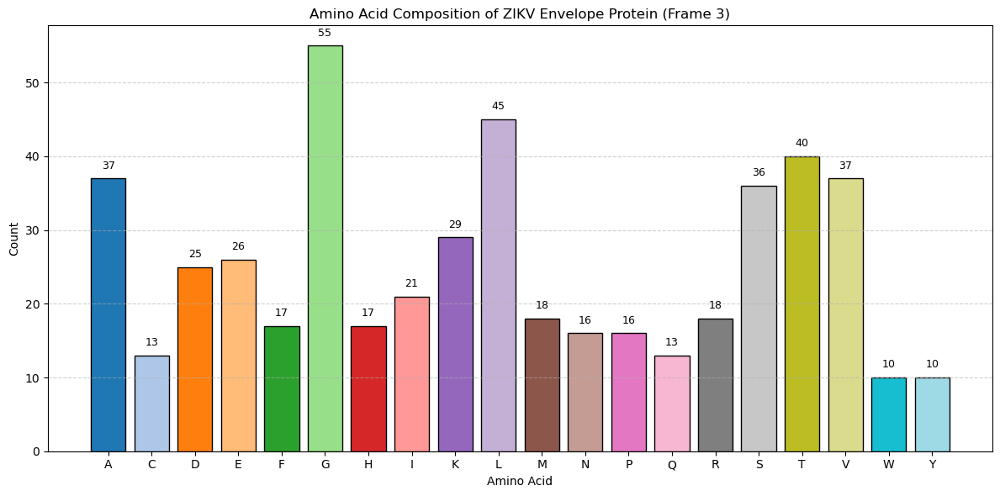

In [56]:


import matplotlib.pyplot as plt

# Amino acid counts
aa_counts = {
    'A': 37, 'C': 13, 'D': 25, 'E': 26, 'F': 17, 'G': 55, 'H': 17, 'I': 21,
    'K': 29, 'L': 45, 'M': 18, 'N': 16, 'P': 16, 'Q': 13, 'R': 18, 'S': 36,
    'T': 40, 'V': 37, 'W': 10, 'Y': 10
}

# Separate color for each bar
colors = plt.cm.tab20.colors  # 20 distinct colors
aa_list = list(aa_counts.keys())
counts = list(aa_counts.values())

# Plotting
plt.figure(figsize=(12, 6))
bars = plt.bar(aa_list, counts, color=colors[:len(aa_list)], edgecolor='black')

# Add count labels above each bar
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 1, str(height),
             ha='center', va='bottom', fontsize=9)

# Labels and title
plt.xlabel('Amino Acid')
plt.ylabel('Count')
plt.title('Amino Acid Composition of ZIKV Envelope Protein (Frame 3)')
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()


In [15]:
# PSIPRED Predicted Secondary Structure — ZIKV Envelope Protein
# BELOW cartoon visualizes the folding pattern predicted from the amino acid sequence.
# It includes the following secondary structure elements:

# - Red spirals: α-helices
# - Yellow arrows: β-strands
# - Gray lines: coils or unstructured regions

# Note: This image does NOT include chemical property-based coloring (e.g., hydrophobic, polar).
# It is purely based on sequence-derived secondary structure prediction.




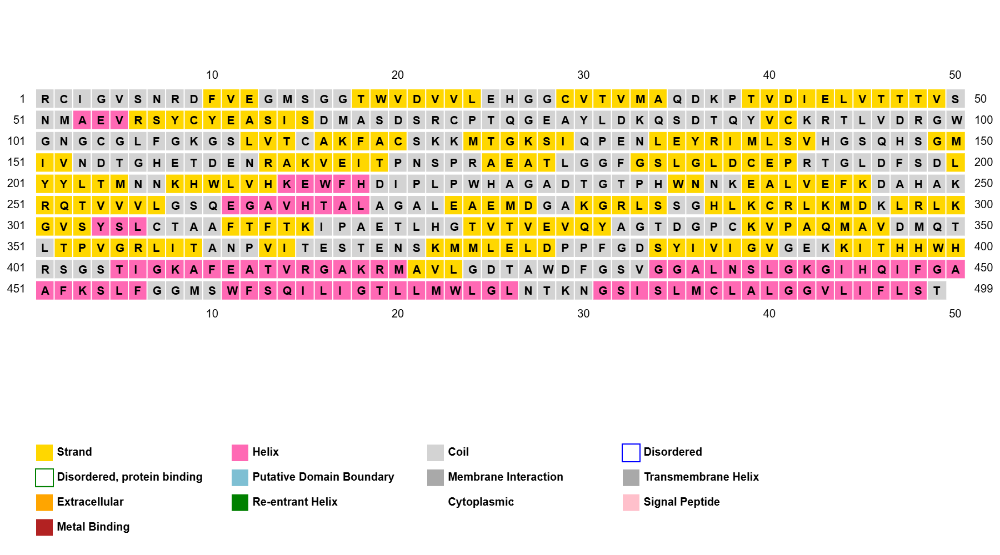

In [7]:
from IPython.display import Image
Image(filename="C:/Users/boini/Downloads/annotationGrid.png")



In [17]:
## PSIPRED Folding Chart — ZIKV Envelope Protein

#BELOW chart shows the predicted secondary structure of the ZIKV envelope protein.  
 #🩷 Pink bars:H → α-helices  
  #🟨 Yellow arrows:- E → β-Strand (extended strand in a beta sheet)

  #⬜ Gray lines:C→ coils  

#Below the folding cartoon:
#- `AA`: Amino acid sequence  
# `Pred`: Predicted structure (H = helix, E = strand, C = coil)  
# `Conf`: Confidence score for each prediction  with varing intensity of blue 
# height of each blue box = Confidence score

#This visualization supports interpretation of folding domains, structural motifs, and prediction reliability.


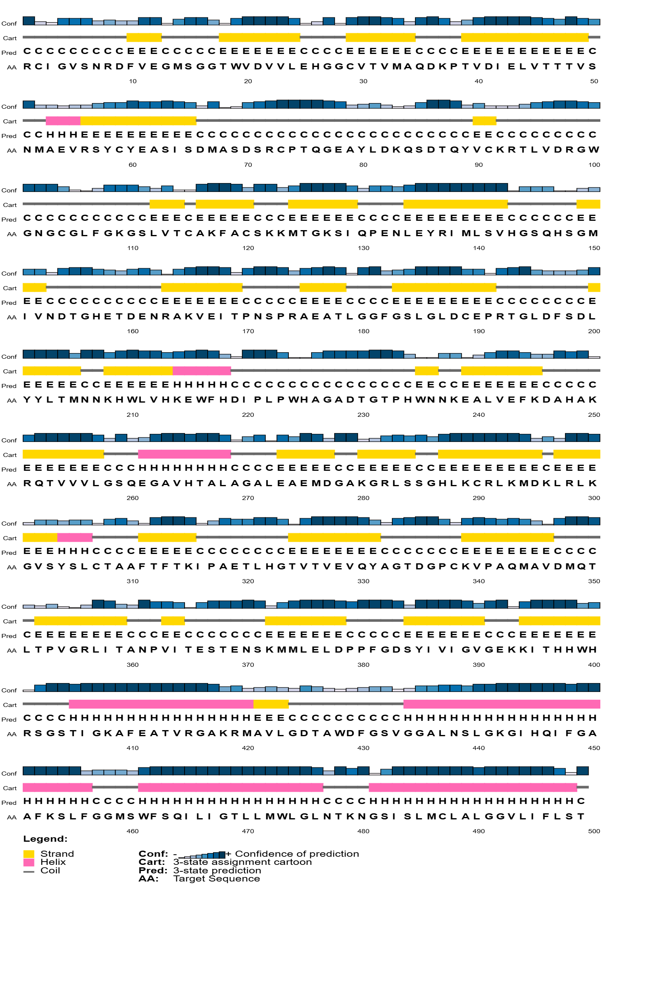

In [13]:
Image(filename="C:/Users/boini/Downloads/psipredChart.png")

In [34]:

#  SWISS-MODEL Works: Homology-Based 3D Structure Prediction

# SWISS-MODEL is a web-based tool that predicts the 3D structure of a protein using
# comparative (homology) modeling. It builds your protein’s structure by aligning it
# to known structures of similar proteins in the Protein Data Bank (PDB).
#
## Workflow Overview

# 1. Input Sequence  
#    The user provides an amino acid sequence in FASTA format.

# 2. Template Search  
#    SWISS-MODEL searches the PDB for homologous proteins with known 3D structures.

# 3. Template Selection  
#    It selects the best match based on sequence identity, coverage, and resolution.

# 4. Model Building  
#    The tool aligns the input sequence to the selected template and builds a 3D model
#    using conserved structural features.
#
# 5. Quality Assessment  
#    It calculates scores such as:  
#    - GMQE (Global Model Quality Estimate): Combines template quality and alignment accuracy.  
#    - QMEANDisCo Global and Local: Measures how well the model matches known protein structures
#      globally and per residue.

# 6. Output  
#    The user receives:  
#    - A downloadable PDB file  
#    - Visual previews of the structure  
#    - Quality plots for interpretation
#
#  Why It’s Ideal for ZIKV Envelope Protein
#
# The ZIKV E protein has high similarity to known structures (e.g., PDB: 5CO8).  
# SWISS-MODEL uses these templates to build accurate, publication-grade models.  
# The resulting structure can be annotated with fusion loop, transmembrane helices,
# and glycosylation sites for functional analysis and outreach.



In [58]:
# 🧬 ZIKV Envelope Protein Structure Prediction and Visualization



In [64]:
!pip install py3Dmol
import py3Dmol, requests

pdb = requests.get("https://files.rcsb.org/download/6CO8.pdb").text
view = py3Dmol.view(width=700, height=500)
view.addModel(pdb, "pdb")
view.setStyle({"cartoon": {"color": "spectrum"}})
view.zoomTo()
view.show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [70]:

 # Create viewer
view = py3Dmol.view(width=800, height=500)
view.setBackgroundColor("white")
view.addModel(pdb, "pdb")

# Get list of chains (manually or via inspection)
chains = ["A", "B", "C", "D", "E", "F"]  # Adjust based on actual structure

# Assign unique colors and labels
colors = ["red", "green", "blue", "orange", "purple", "teal"]

for i, chain in enumerate(chains):
    view.setStyle({"chain": chain}, {"cartoon": {"color": colors[i]}})
    view.addLabel(f"Chain {chain}", {
        "position": {"chain": chain, "resn": "GLY", "resi": 1},
        "backgroundColor": "white",
        "fontColor": colors[i],
        "fontSize": 14
    })

view.zoomTo()
view.show()


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [74]:
# Create separate viewers for each chain
for i, chain in enumerate(chains):
    view = py3Dmol.view(width=400, height=400)
    view.setBackgroundColor("white")
    view.addModel(pdb, "pdb")
    
    # Show only the current chain
    view.setStyle({"chain": chain}, {"cartoon": {"color": colors[i]}})
    
    # Optional: label the chain
    view.addLabel(f"Chain {chain}", {
        "position": {"chain": chain, "resi": 1},
        "backgroundColor": "white",
        "fontColor": colors[i],
        "fontSize": 14
    })
    
    view.zoomTo({"chain": chain})
    view.show()



3Dmol.js failed to load for some reason. Please check your browser console for error messages.

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

3Dmol.js failed to load for some reason. Please check your browser console for error messages.